In [1]:
!conda install -y tensorflow-gpu"=>2.1.0"

Solving environment: | 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:

  - defaults/linux-64::bkcharts==0.2=py36_0
  - defaults/noarch::dask==2.14.0=py_0
  - defaults/linux-64::pytest-arraydiff==0.3=py36h39e3cac_0
  - defaults/linux-64::bottleneck==1.3.2=py36heb32a55_0
  - defaults/linux-64::pywavelets==1.1.1=py36h7b6447c_0
  - defaults/noarch::keras-preprocessing==1.1.0=py_1
  - defaults/noarch::pytest-astropy==0.8.0=py_0
  - defaults/noarch::keras==2.4.3=0
  - defaults/linux-64::numexpr==2.7.1=py36h423224d_0
  - defaults/linux-64::h5py==2.10.0=py36h7918eee_0
  - defaults/linux-64::pandas==1.0.5=py36h0573a6f_0
  - defaults/linux-64::numpy-base==1.18.1=py36hde5b4d6_1
  - defaults/linux-64::tensorflow==2.2.0=gpu_py36hf933387_0
  - defaults/linux-64::tensorflow-gpu==2.2.0=h0d30ee6_0
  - defaults/linux-64::patsy==0.5.1=py36_0
  - defaults/linux-64::scikit-image==0.16.2=py36h0573a6f_0
  - defaults/linux-64::ma

In [2]:
import matplotlib.pyplot as plt
from tensorflow.python.client import device_lib
device_lib.list_local_devices()



[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 6427354946242152040,
 name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 13323118116735249105
 physical_device_desc: "device: XLA_CPU device",
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 15625444416
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 14682261389233286080
 physical_device_desc: "device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:00:1e.0, compute capability: 7.0",
 name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 394488205246912881
 physical_device_desc: "device: XLA_GPU device"]

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.animation as animation
import os
import cv2 as cv
from random import randint

def normalize(array):

    normalized = (array - np.amin(array)) / (np.amax(array) - np.amin(array))

    return normalized

class GANDatasetSingle:

    def __init__(self, in_path, out_path, filelimiter): #if filelimiter is -1 or > 943, unlimited.
        
        self.in_path = in_path
        self.out_path = out_path

        self.x_train = []
        self.y_train = []

        self.x_train_files = os.listdir(in_path)
        self.y_train_files = os.listdir(out_path)

        for i in range(0, len(self.x_train_files)):

            self.x_train_files[i] = self.x_train_files[i][0:4]

        for i in range(0, len(self.y_train_files)):

            self.y_train_files[i] = self.y_train_files[i][0:4]

        print("Length of x_train files: {}".format(len(self.x_train_files)))
        print("Length of y_train files: {}".format(len(self.y_train_files)))

        main_list = np.setdiff1d(self.x_train_files, self.y_train_files)

        print("LENGTH OF MAIN LIST: {}".format(len(main_list)))

        '''

        for item in main_list:

            if (item[0] != '.'):

                if item in x_train_files:

                    os.remove(os.path.join(in_path, item + ".png"))
                
                elif item in y_train_files:

                    os.remove(os.path.join(out_path, item + ".npy"))

        '''

        # ^^ removing files present in one (x, y) and not other (x, y) to prevent dataset misalignment

        self.x_train_paths = []
        self.y_train_paths = []

        for item in os.listdir(in_path):

            if (item[-3: ] == 'png'):

                self.x_train_paths.append(item)

        for item in os.listdir(out_path):

            if (item[-3: ] == 'npy'):

                self.y_train_paths.append(item)

        self.x_train_paths = sorted(self.x_train_paths)
        self.y_train_paths = sorted(self.y_train_paths)

        self.keys = []

        for file in self.y_train_paths:

            self.keys.append(file[0:4])

        print("Length of keys: {}".format(len(self.keys)))

        if (filelimiter < 1 or filelimiter> len(self.x_train_paths)):

            filelimiter = len(self.x_train_paths)

        for i in range(0, filelimiter):

            pt_in = os.path.join(in_path, self.x_train_paths[i])
            pt_out = os.path.join(out_path, self.y_train_paths[i])

            self.x_train.append(cv.imread(pt_in, cv.IMREAD_GRAYSCALE))
            self.y_train.append(np.load(pt_out))

        self.x_train = np.array(self.x_train).astype('float64')
        self.x_train /= np.amax(self.x_train)
        
        for i in range(0, len(self.y_train)):

            item = self.y_train[i]
            item = np.clip(item, -1000, 3000)
            print("Item {} with max: {} and min: {}".format(i, np.amax(self.y_train[i]), np.amin(self.y_train[i])))
            normalized = normalize(item)
            self.y_train[i] = normalized
            print("Normalized item {} with max: {} and min: {}".format(i, np.amax(self.y_train[i]), np.amin(self.y_train[i])))
        
        self.y_train = np.array(self.y_train).astype('float64')


    def view_pair(self, index):

        f = plt.figure()

        f.add_subplot(1, 2, 1)
        plt.imshow(self.x_train[index], cmap = 'gray')
        plt.title('Radiograph of {}'.format(index))
        f.add_subplot(1, 2, 2)
        plt.imshow(self.y_train[index][64], cmap = 'gray')
        plt.title("Tomography of {}".format(index))
        plt.show(block = True)

    def view_animation(self, index):

        if (self.y_train):

            array = self.y_train[index]

            ims = []

            for im in array:

                gg = plt.imshow(im, cmap = 'gray')
                ims.append([gg])

            fig = plt.figure()
            ani = animation.ArtistAnimation(fig, ims, interval = 50, blit = True)
            plt.title(index)
            plt.show()

        else:

            print("Error: dataset has not been initialized yet")

    def prepare(self, num_train):

        self.x_val = self.x_train[num_train: len(self.x_train)]
        self.x_train = self.x_train[0:num_train]


        self.y_val = self.y_train[num_train : len(self.y_train)]
        self.y_train = self.y_train[0: num_train]


        self.x_train = np.reshape(self.x_train, (len(self.x_train), 1024, 1024, 1))
        self.y_train = np.reshape(self.y_train, (len(self.y_train), 128, 128, 128, 1))

        self.x_val = np.reshape(self.x_val, (len(self.x_val), 1024, 1024, 1))
        self.y_val = np.reshape(self.y_val, (len(self.y_val), 128, 128, 128, 1))

        print("Shape of X Train: {}".format(self.x_train.shape))
        print("Shape of Y Train: {}".format(self.y_train.shape))
        print("Shape of X Validation: {}".format(self.x_val.shape))
        print("Shape of Y Validation: {}".format(self.y_val.shape))

    def save_data(self, model, truth_out_dir, pred_out_dir, save_truths = False):

        self.model = model #tensorflow.keras model

        for i in range(0, len(self.keys)):

            input = np.reshape(self.x_train[i], (1, 1024, 1024, 1))
            output = model.predict(input)
            output = np.reshape(output, (128, 128, 128))

            if (save_truths):

                truth = np.reshape(self.y_train[i], (128, 128, 128))
                np.save(os.path.join(truth_out_dir, self.keys[i]), truth)

            np.save(os.path.join(pred_out_dir, self.keys[i]), output)
            print(self.keys[i])

    def generate_real_samples(self, n_samples, patch_shape):

        ix = np.random.randint(0, self.x_train.shape[0], n_samples)

        X1, X2 = self.x_train[ix], self.y_train[ix]
        
        y = np.ones((n_samples, patch_shape, patch_shape, 1))
        return [X1, X2], y

    def generate_fake_samples(self, g_model, samples, patch_shape):

        X = g_model.predict(samples)
        y = np.zeros((len(X), patch_shape, patch_shape, 1))
        return X, y

    def train(self, d_model, g_model, gan_model, n_epochs = 100, n_batch = 1, n_patch = 16):

        bat_per_epo = int(len(self.x_train) / n_batch)

        n_steps = bat_per_epo * n_epochs

        for i in range(n_steps):

            [X_realA, X_realB], y_real = self.generate_real_samples(n_batch, n_patch)
            X_fakeB, y_fake = self.generate_fake_samples(g_model, X_realA, n_patch)
            d_loss1 = d_model.train_on_batch([X_realA, X_realB], y_real)
            d_loss2 = d_model.train_on_batch([X_realA, X_fakeB], y_fake)

            g_loss, _, _ = gan_model.train_on_batch(X_realA, [y_real, X_realB])

            print('>%d, d1[%.3f] d2[%.3f] g[%.3f]' % (i+1, d_loss1, d_loss2, g_loss))


In [4]:
gd = GANDatasetSingle('In/0', 'Out_New', 0)

Length of x_train files: 943
Length of y_train files: 943
LENGTH OF MAIN LIST: 0
Length of keys: 943
Item 0 with max: 3482 and min: -2180
Normalized item 0 with max: 1.0 and min: 0.0
Item 1 with max: 1681 and min: -1108
Normalized item 1 with max: 1.0 and min: 0.0
Item 2 with max: 5660 and min: -2212
Normalized item 2 with max: 1.0 and min: 0.0
Item 3 with max: 3564 and min: -1221
Normalized item 3 with max: 1.0 and min: 0.0
Item 4 with max: 3452 and min: -2218
Normalized item 4 with max: 1.0 and min: 0.0
Item 5 with max: 3378 and min: -2213
Normalized item 5 with max: 1.0 and min: 0.0
Item 6 with max: 3744 and min: -2186
Normalized item 6 with max: 1.0 and min: 0.0
Item 7 with max: 3495 and min: -2201
Normalized item 7 with max: 1.0 and min: 0.0
Item 8 with max: 1730 and min: -1078
Normalized item 8 with max: 1.0 and min: 0.0
Item 9 with max: 3420 and min: -1118
Normalized item 9 with max: 1.0 and min: 0.0
Item 10 with max: 3547 and min: -2167
Normalized item 10 with max: 1.0 and min:

In [5]:
gd.prepare(943)

Shape of X Train: (943, 1024, 1024, 1)
Shape of Y Train: (943, 128, 128, 128, 1)
Shape of X Validation: (0, 1024, 1024, 1)
Shape of Y Validation: (0, 128, 128, 128, 1)


In [6]:
!conda install keras --yes

Solving environment: | 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:

  - defaults/linux-64::bkcharts==0.2=py36_0
  - defaults/noarch::dask==2.14.0=py_0
  - defaults/linux-64::pytest-arraydiff==0.3=py36h39e3cac_0
  - defaults/linux-64::bottleneck==1.3.2=py36heb32a55_0
  - defaults/linux-64::pywavelets==1.1.1=py36h7b6447c_0
  - defaults/noarch::keras-preprocessing==1.1.0=py_1
  - defaults/noarch::pytest-astropy==0.8.0=py_0
  - defaults/noarch::keras==2.4.3=0
  - defaults/linux-64::numexpr==2.7.1=py36h423224d_0
  - defaults/linux-64::h5py==2.10.0=py36h7918eee_0
  - defaults/linux-64::pandas==1.0.5=py36h0573a6f_0
  - defaults/linux-64::numpy-base==1.18.1=py36hde5b4d6_1
  - defaults/linux-64::tensorflow==2.2.0=gpu_py36hf933387_0
  - defaults/linux-64::tensorflow-gpu==2.2.0=h0d30ee6_0
  - defaults/linux-64::patsy==0.5.1=py36_0
  - defaults/linux-64::scikit-image==0.16.2=py36h0573a6f_0
  - defaults/linux-64::ma

In [7]:
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Conv3D, MaxPooling3D, UpSampling3D, Reshape, Flatten, Dense
from keras.layers.merge import concatenate
from keras.models import Model
from keras.datasets import mnist
from keras.callbacks import TensorBoard
from keras import backend as K
from keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
import numpy as np
import matplotlib.pyplot as plt
import pickle

def define_discriminator():

  input_img_1 = Input(shape=(128, 128, 128, 1))    # adapt this if using 'channels_first' image data format
  input_img_2 = Input(shape = (1024, 1024, 1))

  x = Conv3D(64, (3, 3, 3), activation='relu', padding='same')(input_img_1)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(128, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(256, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(512, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(1024, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Conv3D(2048, (3, 3, 3), activation='relu', padding='same')(x)
  x = MaxPooling3D((2, 2, 2), padding='same')(x)
  x = Reshape((2, 2, 4096))(x)

  y = Conv2D(32, (3, 3), activation = "relu", padding = 'same')(input_img_2)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(64, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(128, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(256, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(512, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(512, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(1024, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(2048, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)
  y = Conv2D(4096, (3, 3), activation = "relu", padding = 'same')(y)
  y = MaxPooling2D((2, 2), padding = 'same')(y)

  encoded = concatenate([x, y])
  encoded = Reshape(target_shape=(32, 32, 32))(encoded)
  encoded = Conv2D(16, (3, 3), activation = 'relu', padding = 'same')(encoded)
  encoded = MaxPooling2D((2, 2), padding = 'same')(encoded)
  encoded = Conv2D(1, (1, 1), activation = 'relu', padding = 'same')(encoded)
  
  discriminator = Model([input_img_2, input_img_1], encoded)
  discriminator.summary()

  opt = Adam(learning_rate=0.0002, beta_1 = 0.5)
  discriminator.compile(loss = 'binary_crossentropy', optimizer = opt, loss_weights = [0.5])
  return discriminator

d_model = define_discriminator()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 1024, 1024,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 1024, 1024, 3 320         input_2[0][0]                    
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 512, 512, 32) 0           conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 64) 18496       max_pooling2d[0][0]              
______________________________________________________________________________________________

In [8]:
from keras.initializers import RandomNormal

def define_generator():

  input_img = Input((1024, 1024, 1))

  init = RandomNormal(stddev = 0.02)

  x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(512, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(1024, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(2048, (3, 3), activation='relu', padding='same')(x)
  x = MaxPooling2D((2, 2), padding='same')(x)
  x = Conv2D(4096, (3, 3), activation='relu', padding='same', kernel_initializer=init)(x)
  encoded = MaxPooling2D((2, 2), padding='same')(x)

  encoded = Reshape((4, 4, 4, 1024))(encoded)

  x = Conv3D(512, (3, 3, 3), activation = 'relu', padding = 'same')(encoded)
  x = UpSampling3D((2, 2, 2))(x)

  x = Conv3D(256, (3, 3, 3), activation = 'relu', padding = 'same')(x)
  x = UpSampling3D((2, 2, 2))(x)

  x = Conv3D(128, (3, 3, 3), activation = 'relu', padding = 'same')(x)
  x = UpSampling3D((2, 2, 2))(x)

  x = Conv3D(64, (3, 3, 3), activation = 'relu', padding = 'same')(x)
  x = UpSampling3D((2, 2, 2))(x)

  x = Conv3D(32, (3, 3, 3), activation = 'relu', padding = 'same')(x)
  x = UpSampling3D((2, 2, 2))(x)

  decoded = Conv3D(1, (1, 1, 1), activation = 'relu', padding = 'same')(x)

  generator = Model(input_img, decoded)
  return generator

g_model = define_generator()

In [9]:
def make_gan(g_model, d_model):

  d_model.trainable = False
   
  in_src = Input((1024, 1024, 1))

  gen_out = g_model(in_src)

  dis_out = d_model([in_src, gen_out])

  model = Model(in_src, [dis_out, gen_out])

  opt = Adam(lr = 0.0002, beta_1 = 0.5)
  model.compile(loss = ['binary_crossentropy', 'mse'], optimizer = opt, loss_weights = [1, 100])
  return model

In [10]:
gan = make_gan(g_model, d_model)

In [11]:
gan.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 1024, 1024,  0                                            
__________________________________________________________________________________________________
model_1 (Model)                 (None, 128, 128, 128 119522561   input_4[0][0]                    
__________________________________________________________________________________________________
model (Model)                   (None, 16, 16, 1)    178459553   input_4[0][0]                    
                                                                 model_1[1][0]                    
Total params: 297,982,114
Trainable params: 119,522,561
Non-trainable params: 178,459,553
__________________________________________________________________________________________________


In [12]:
plot_model(gan, show_shapes = True)

Failed to import pydot. You must install pydot and graphviz for `pydotprint` to work.


In [18]:
gd.train(d_model, g_model, gan, 20, 1, 16)

>1, d1[0.473] d2[6.752] g[0.924]
>2, d1[0.473] d2[6.752] g[2.043]
>3, d1[0.473] d2[6.752] g[1.983]
>4, d1[0.473] d2[6.752] g[1.808]
>5, d1[0.473] d2[6.752] g[1.982]
>6, d1[0.473] d2[6.752] g[2.305]
>7, d1[0.473] d2[6.752] g[3.160]
>8, d1[0.473] d2[6.751] g[1.845]
>9, d1[0.473] d2[6.752] g[2.056]
>10, d1[0.473] d2[6.752] g[1.818]
>11, d1[0.473] d2[6.752] g[1.477]
>12, d1[0.473] d2[6.752] g[2.116]
>13, d1[0.473] d2[6.752] g[1.532]
>14, d1[0.473] d2[6.752] g[1.678]
>15, d1[0.473] d2[6.752] g[2.616]
>16, d1[0.473] d2[6.752] g[1.410]
>17, d1[0.473] d2[6.752] g[1.776]
>18, d1[0.473] d2[6.752] g[1.573]
>19, d1[0.473] d2[6.752] g[1.527]
>20, d1[0.473] d2[6.751] g[2.255]
>21, d1[0.473] d2[6.752] g[3.621]
>22, d1[0.473] d2[6.752] g[3.082]
>23, d1[0.473] d2[6.752] g[1.653]
>24, d1[0.473] d2[6.752] g[1.422]
>25, d1[0.473] d2[6.751] g[1.482]
>26, d1[0.473] d2[6.752] g[1.437]
>27, d1[0.473] d2[6.752] g[1.454]
>28, d1[0.473] d2[6.752] g[1.757]
>29, d1[0.473] d2[6.752] g[3.132]
>30, d1[0.473] d2[6.751

In [19]:
test_vv = g_model.predict(np.reshape(gd.x_train[100], (1, 1024, 1024, 1)))


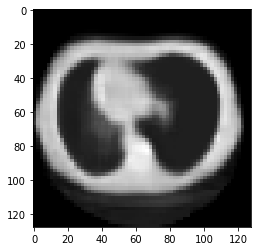

In [20]:
test_vv = np.reshape(test_vv, (128, 128, 128))

plt.imshow(test_vv[64], cmap = 'gray')
plt.show()

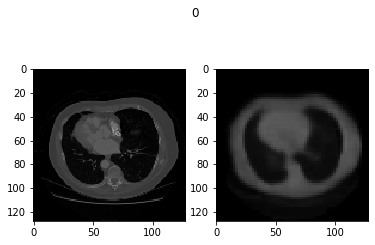

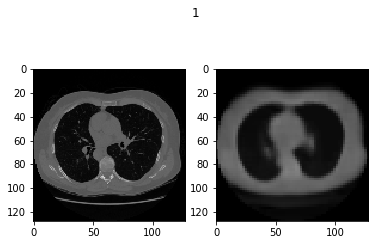

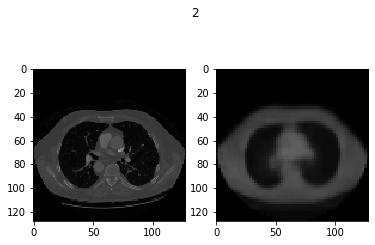

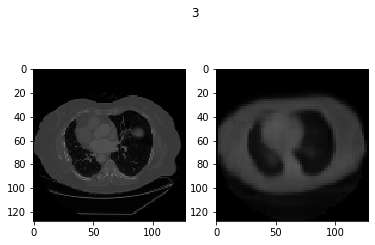

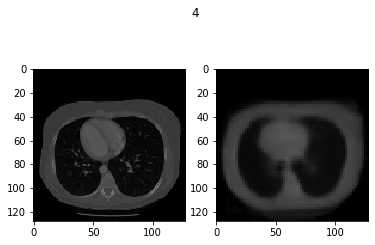

...

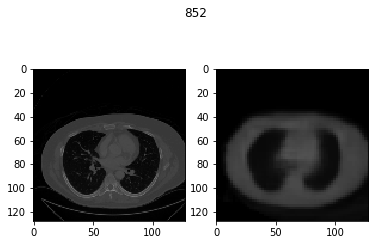

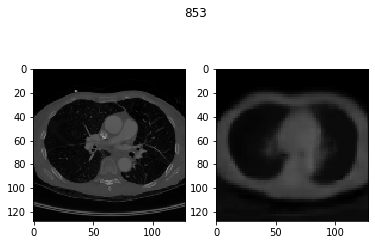

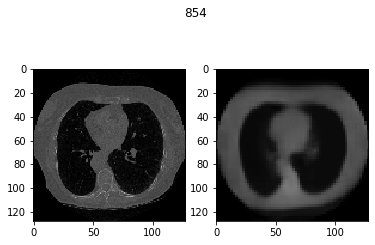

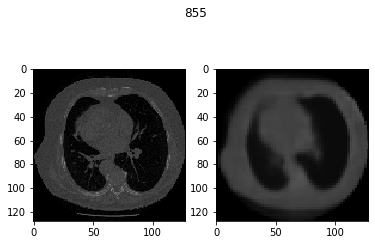

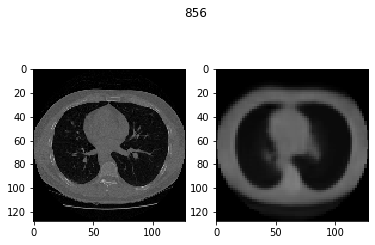

In [ ]:
for i in range(0, 943):
    
    test_vv = g_model.predict(np.reshape(gd.x_train[i], (1, 1024, 1024, 1)))
    test_vv = np.reshape(test_vv, (128, 128, 128))
    actual = np.reshape(gd.y_train[i], (128, 128, 128))
    
    f = plt.figure()
    
    f.add_subplot(1, 2, 1)
    plt.imshow(actual[64], cmap = 'gray', vmin = 0, vmax = 1)
    
    f.add_subplot(1, 2, 2)
    plt.imshow(test_vv[64], cmap = 'gray', vmin = 0, vmax = 1)
    
    plt.suptitle(i)
    plt.show(block = True)